In [126]:
import numpy as np
import matplotlib.pyplot as plt
import pickle
import cv2
import tqdm
import glob
import os
import time

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import pandas as pd


In [127]:
with open('KinectTest.pickle', 'rb') as handle:
    test = pickle.load(handle)

In [132]:
class KinectDataset(Dataset):
    def __init__(self, paths, labels):
        self.paths = paths
        self.labels = labels
        self.GT_labels = {'1': 0, '2': 1, '3': 1, '4': 2, '5': 2, '6': 3, 
                          '7': 2, '8': 3, '9': 5, '10': 3}
        self.h = 480
        self.w = 640
        self.transforms = transforms.Compose([
            transforms.ToPILImage(),
            transforms.CenterCrop((self.h*2, self.w*2)),
            transforms.Resize((self.h//4, self.w//4)),
            transforms.ToTensor()
        ])
        
    def __len__(self):
        return len(self.paths)
    
    def __getitem__(self, idx):
        img = cv2.imread("..\\." + self.paths[idx])
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#         print()
        img = self.transforms(img)
        img = img.permute((1, 2, 0))
        
        label = torch.tensor(self.GT_labels[(self.labels[idx])])
        
        return {'img': img, 'label': label}

In [133]:
TestDataset = KinectDataset(list(test.keys()), list(test.values()))
TestDataLoader = DataLoader(TestDataset, batch_size=1, shuffle=False)
person = [path.split('\\')[3] for path in (TestDataset.paths)]
gesture = [path.split('\\')[4] for path in (TestDataset.paths)]

In [134]:
def eval_test(test_loader, model, loss_fn, device):
    test_total = 0
    test_correct = 0
    preds = [] 
    GT = []
    model.eval()
    with torch.no_grad():
        for i, sample in enumerate(test_loader):

            # move inputs to device
            if torch.cuda.is_available():
                x = sample['img'].permute(0, 3, 1, 2).float().to(device)
                y = sample['label'].to(device)

            output = model.forward(x)
            
            # Calculate accuracy/loss
            _, y_hat = torch.max(output, dim=1)
            preds.append(y_hat.cpu().data.numpy()[0])
            GT.append(y_hat.cpu().data.numpy()[0])
            
            batch_correct = torch.sum(y_hat == y)
            test_correct += batch_correct
            test_total += x.shape[0]
    test_acc = test_correct.float()/test_total
    print(f'Test Acc: {test_acc}')
    return test_acc, preds, GT

In [135]:
import torchvision.models as models
model_name = 'resnext50'
model = models.resnext50_32x4d()
model.fc = nn.Sequential(
    nn.Linear(in_features=2048, out_features=1024, bias=True),
    nn.ReLU(),
    nn.Linear(1024, 512),
    nn.ReLU(),
    nn.Linear(512, 64),
    nn.ReLU(),
    nn.Linear(64,6),
    nn.Softmax(dim=1),    
    )
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.load_state_dict(torch.load("saved_models/" + model_name + ".pth"))
model.to(device)
model.eval()

a = time.time()
epoch_test_accuracy, resnext50_preds, resnext50_GT = eval_test(TestDataLoader, model, nn.CrossEntropyLoss(), device)
print("Time elapsed for evaluating test set is: ", time.time() - a)

Test Acc: 0.11688311398029327
Time elapsed for evaluating test set is:  10.96637773513794


In [136]:
model_name = 'resnet152'
model = models.resnet152()
model.fc = nn.Sequential(
    nn.Linear(in_features=2048, out_features=1024, bias=True),
    nn.ReLU(),
    nn.Linear(1024, 512),
    nn.ReLU(),
    nn.Linear(512, 64),
    nn.ReLU(),
    nn.Linear(64,6),
    nn.Softmax(dim=1),    
    )
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.load_state_dict(torch.load("saved_models/" + model_name + ".pth"))
model.to(device)
model.eval()

a = time.time()
epoch_test_accuracy, resnet152_preds, resnet152_GT = eval_test(TestDataLoader, model, nn.CrossEntropyLoss(), device)
print("Time elapsed for evaluating test set is: ", time.time() - a)

Test Acc: 0.23376622796058655
Time elapsed for evaluating test set is:  13.546690940856934


In [137]:
model_name = 'resnet18'
model = models.resnet18()
model.fc = nn.Sequential(
    nn.Linear(in_features=512, out_features=1000, bias=True),
    nn.ReLU(),
    nn.Linear(1000, 500),
    nn.ReLU(),
    nn.Linear(500,50),
    nn.ReLU(),
    nn.Linear(50,6),
    nn.Softmax(dim=1),    
    )
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.load_state_dict(torch.load("saved_models/" + model_name + ".pth"))
model.to(device)
model.eval()

a = time.time()
epoch_test_accuracy, resnet18_preds, resnet18_GT = eval_test(TestDataLoader, model, nn.CrossEntropyLoss(), device)
print("Time elapsed for evaluating test set is: ", time.time() - a)

Test Acc: 0.3160173296928406
Time elapsed for evaluating test set is:  8.978050947189331


(480, 640, 3)


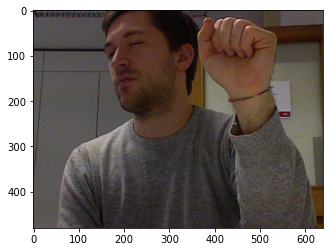

(480, 640, 3)


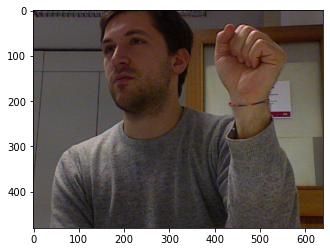

(480, 640, 3)


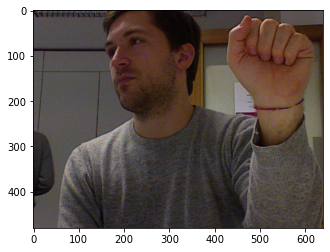

(480, 640, 3)


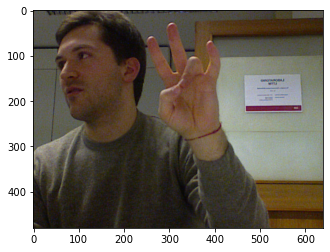

(480, 640, 3)


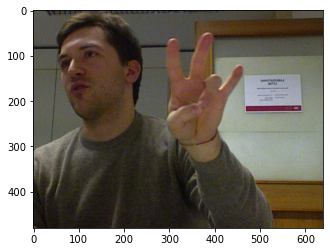

(480, 640, 3)


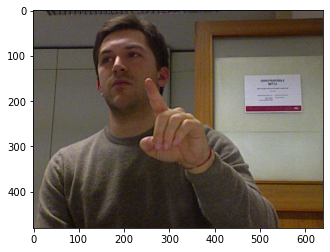

(480, 640, 3)


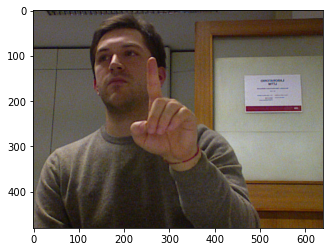

(480, 640, 3)


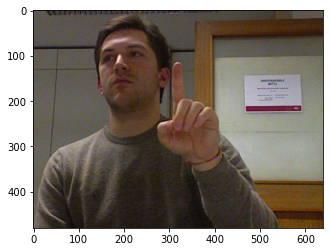

(480, 640, 3)


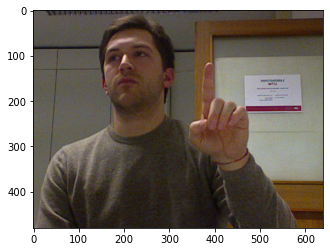

(480, 640, 3)


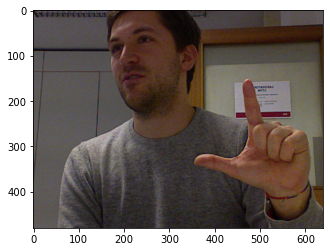

(480, 640, 3)


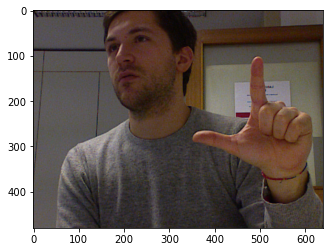

(480, 640, 3)


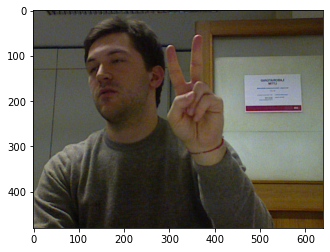

(480, 640, 3)


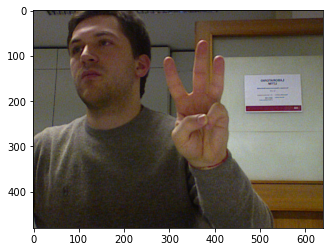

(480, 640, 3)


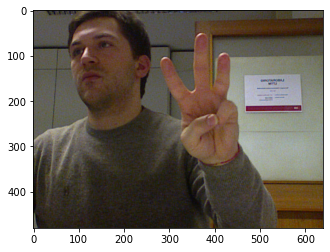

(480, 640, 3)


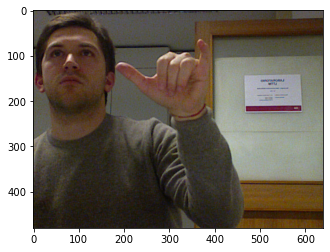

(480, 640, 3)


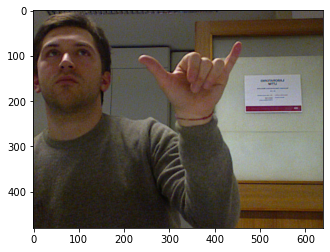

(480, 640, 3)


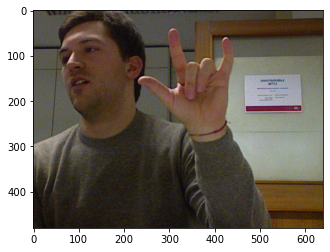

(480, 640, 3)


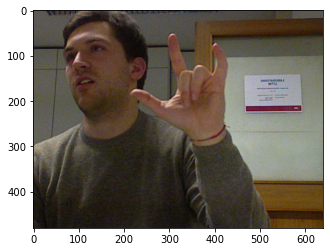

(480, 640, 3)


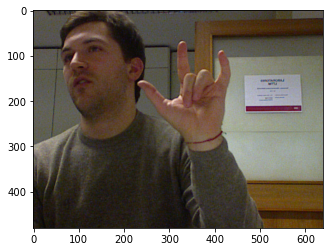

(480, 640, 3)


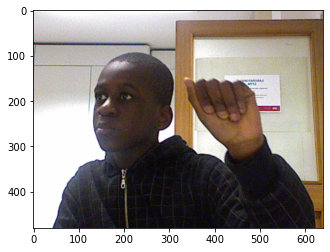

(480, 640, 3)


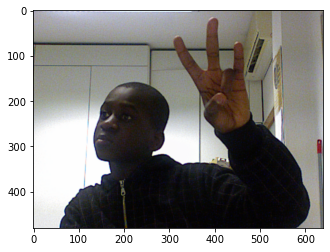

(480, 640, 3)


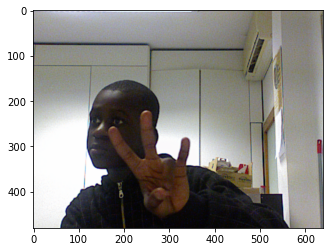

(480, 640, 3)


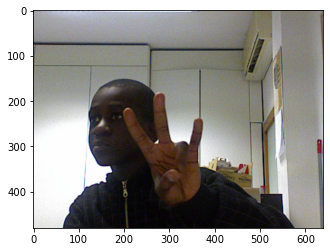

(480, 640, 3)


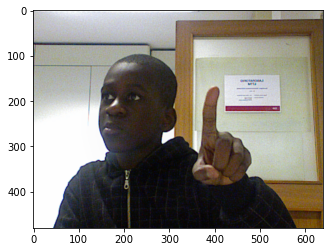

(480, 640, 3)


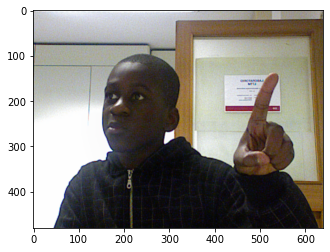

(480, 640, 3)


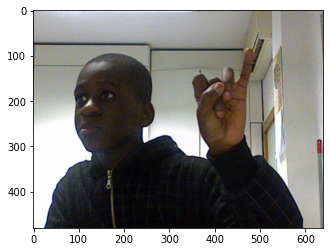

(480, 640, 3)


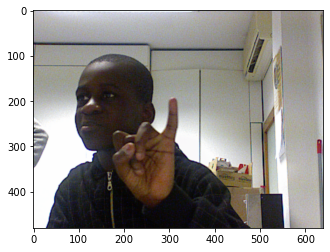

(480, 640, 3)


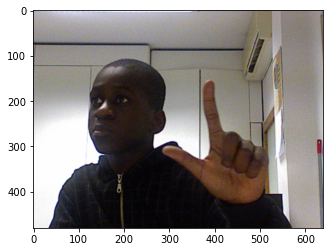

(480, 640, 3)


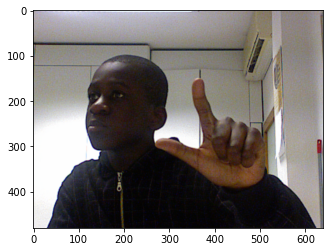

(480, 640, 3)


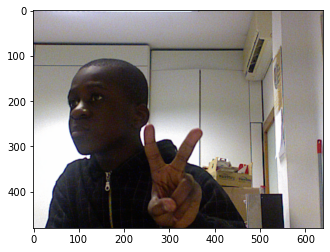

(480, 640, 3)


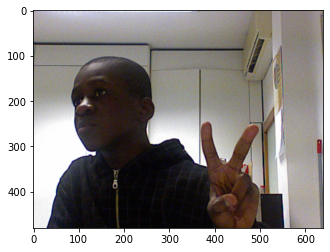

(480, 640, 3)


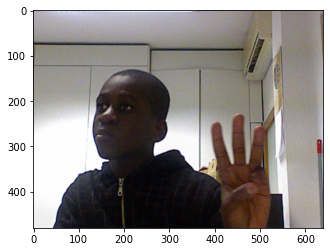

(480, 640, 3)


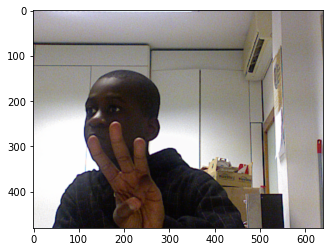

(480, 640, 3)


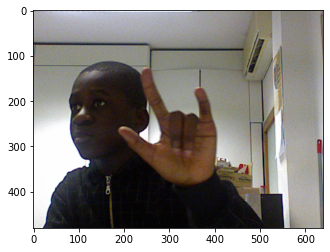

(480, 640, 3)


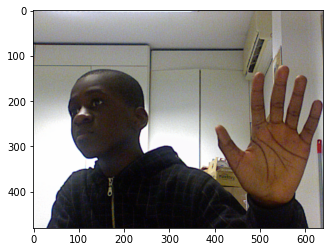

(480, 640, 3)


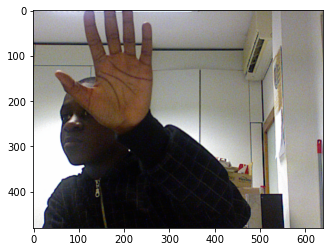

(480, 640, 3)


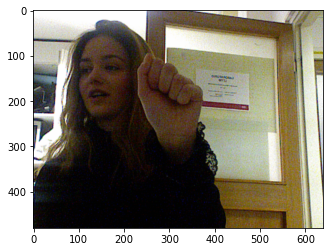

(480, 640, 3)


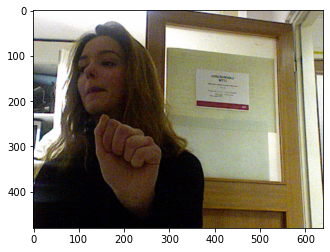

(480, 640, 3)


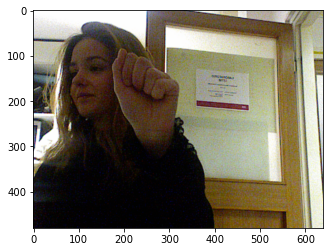

(480, 640, 3)


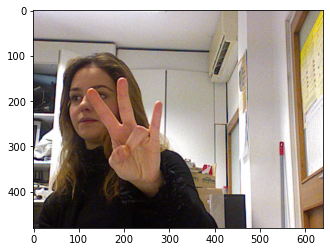

(480, 640, 3)


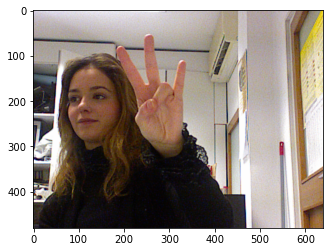

(480, 640, 3)


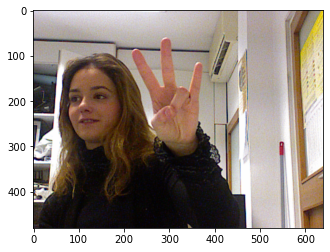

(480, 640, 3)


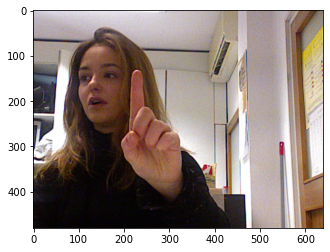

(480, 640, 3)


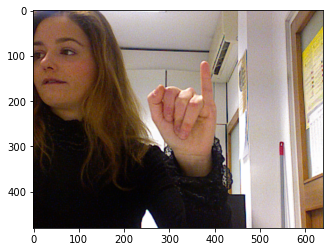

(480, 640, 3)


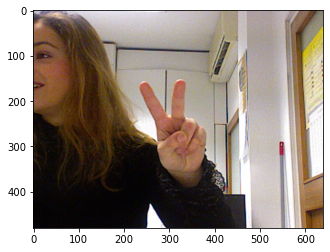

(480, 640, 3)


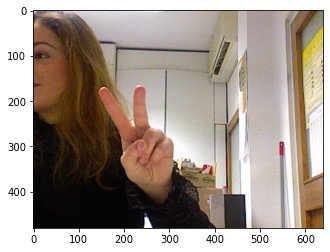

(480, 640, 3)


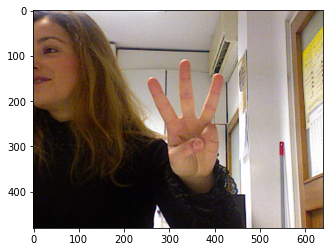

(480, 640, 3)


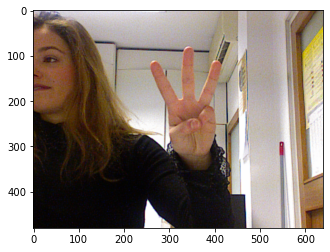

(480, 640, 3)


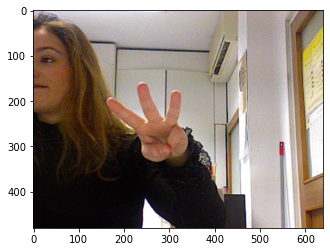

(480, 640, 3)


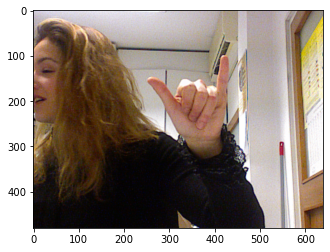

(480, 640, 3)


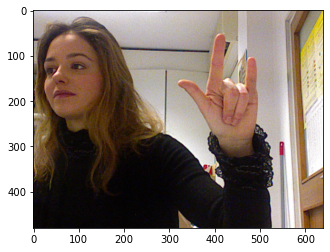

(480, 640, 3)


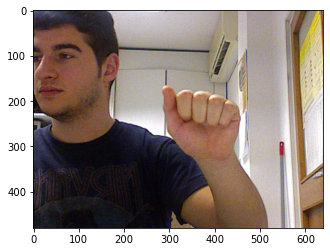

(480, 640, 3)


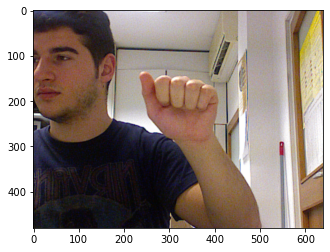

(480, 640, 3)


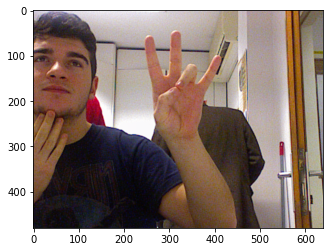

(480, 640, 3)


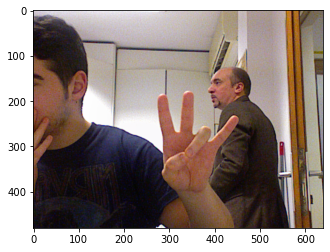

(480, 640, 3)


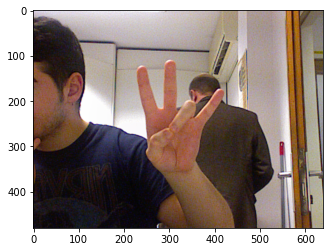

(480, 640, 3)


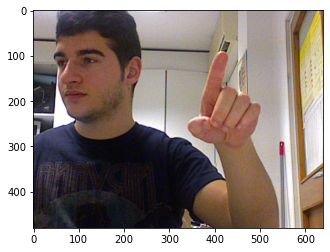

(480, 640, 3)


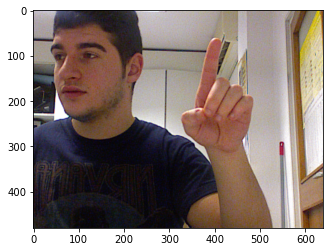

(480, 640, 3)


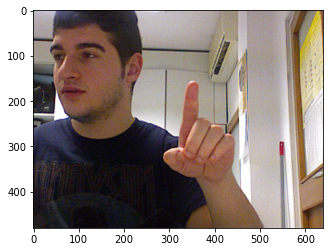

(480, 640, 3)


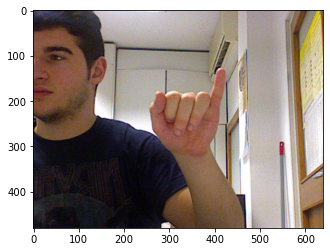

(480, 640, 3)


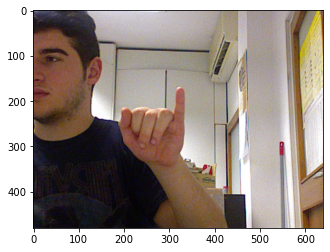

(480, 640, 3)


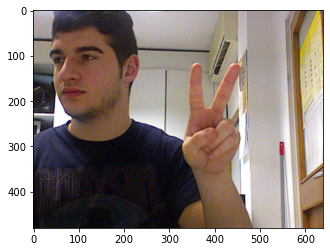

(480, 640, 3)


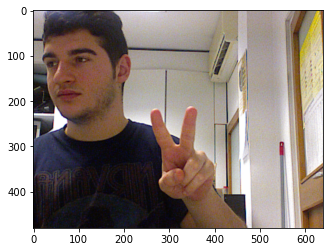

(480, 640, 3)


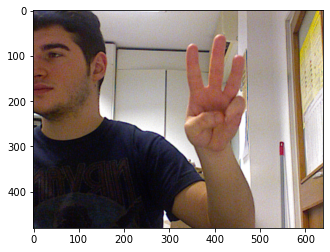

(480, 640, 3)


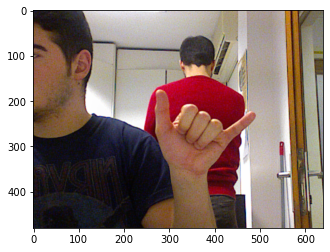

(480, 640, 3)


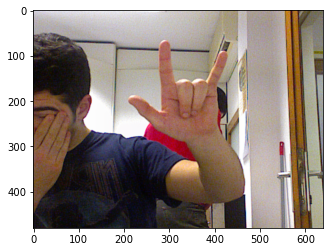

(480, 640, 3)


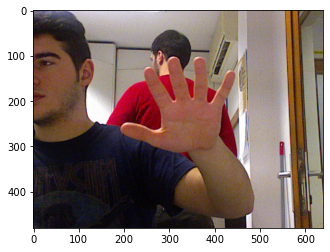

(480, 640, 3)


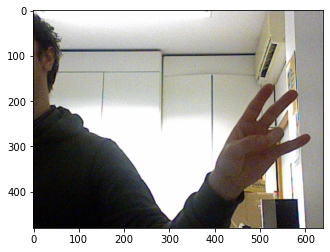

(480, 640, 3)


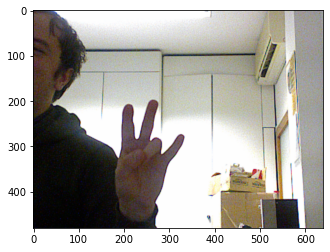

(480, 640, 3)


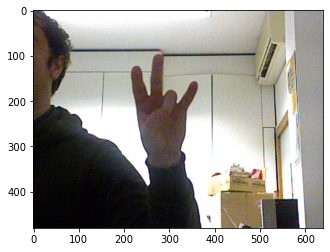

(480, 640, 3)


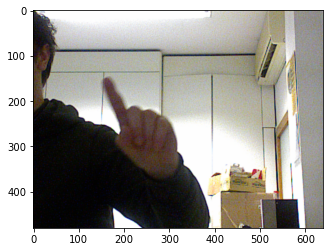

(480, 640, 3)


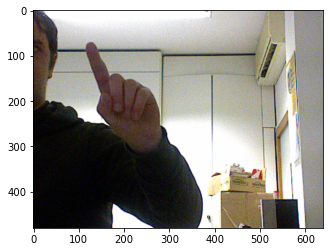

(480, 640, 3)


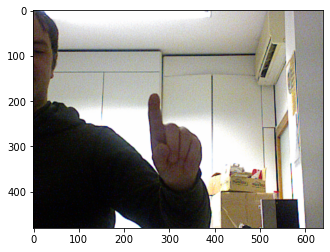

(480, 640, 3)


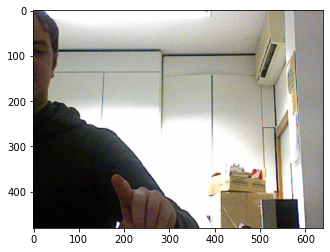

(480, 640, 3)


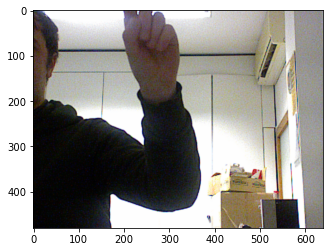

(480, 640, 3)


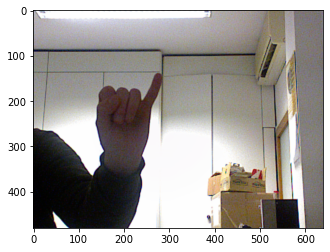

(480, 640, 3)


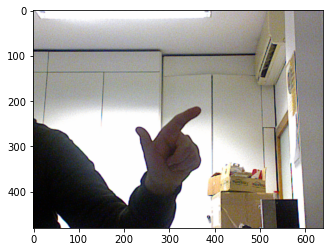

(480, 640, 3)


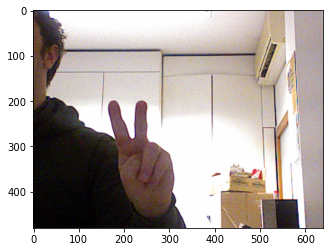

(480, 640, 3)


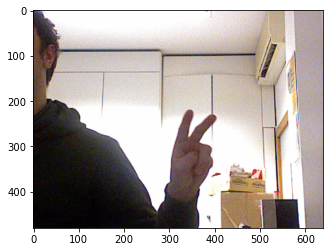

(480, 640, 3)


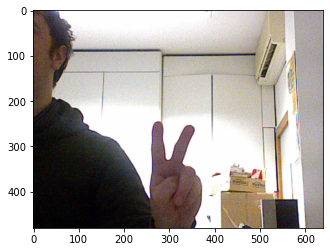

(480, 640, 3)


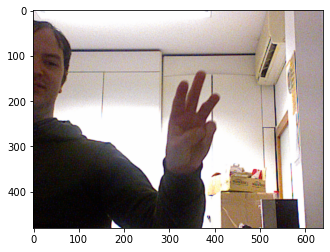

(480, 640, 3)


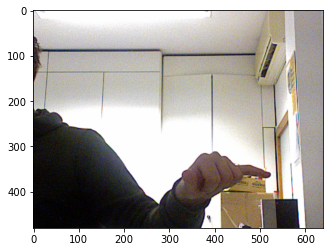

(480, 640, 3)


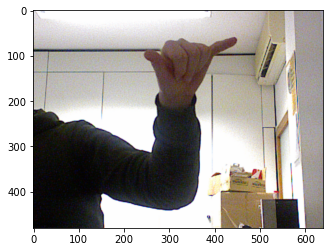

(480, 640, 3)


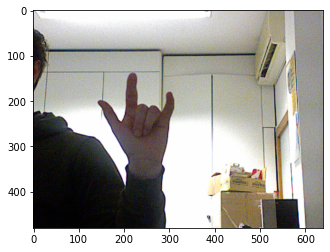

(480, 640, 3)


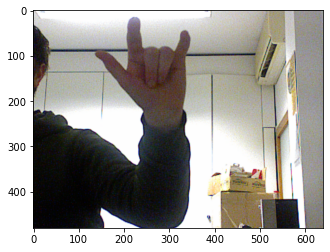

(480, 640, 3)


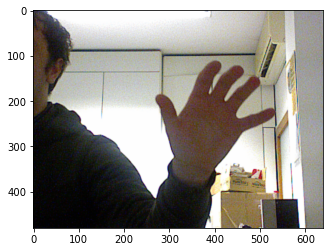

(480, 640, 3)


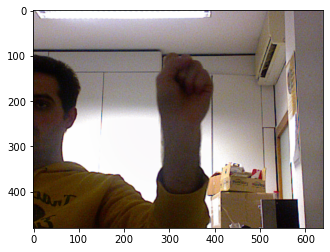

(480, 640, 3)


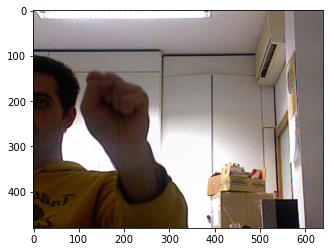

(480, 640, 3)


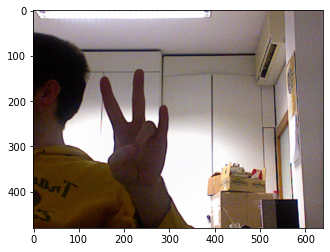

(480, 640, 3)


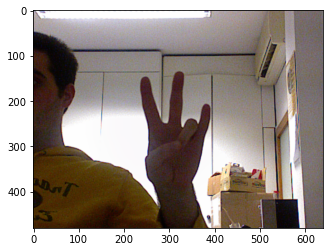

(480, 640, 3)


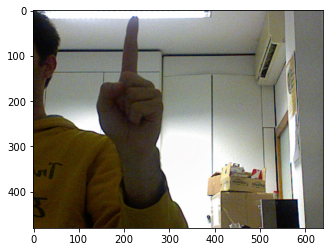

(480, 640, 3)


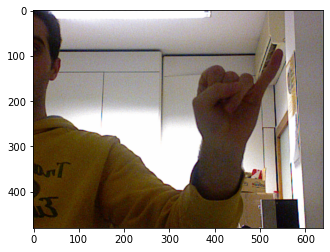

(480, 640, 3)


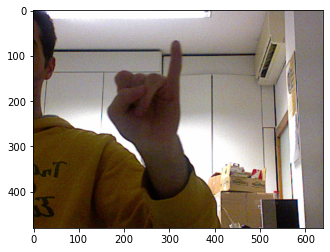

(480, 640, 3)


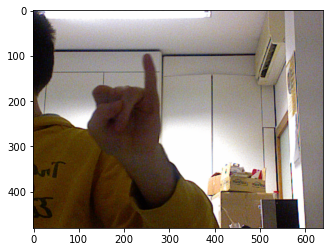

(480, 640, 3)


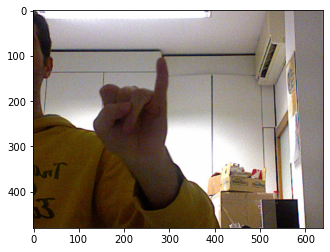

(480, 640, 3)


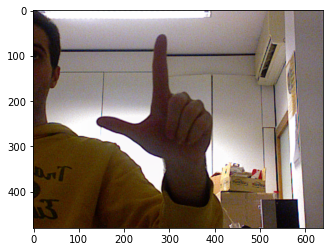

(480, 640, 3)


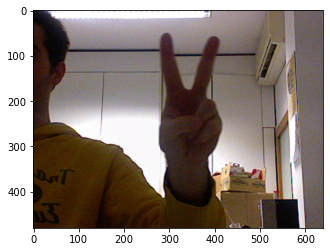

(480, 640, 3)


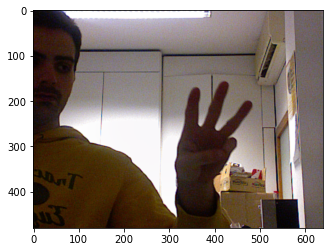

(480, 640, 3)


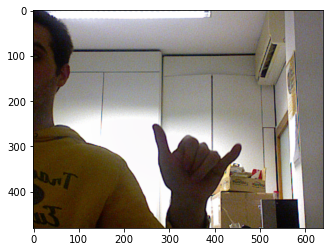

(480, 640, 3)


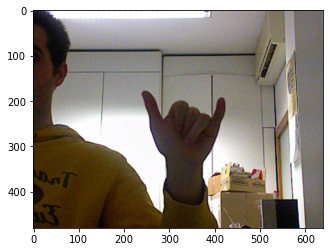

(480, 640, 3)


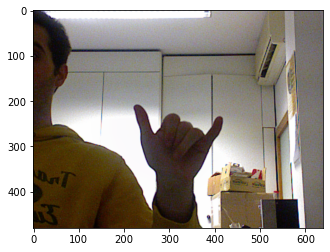

(480, 640, 3)


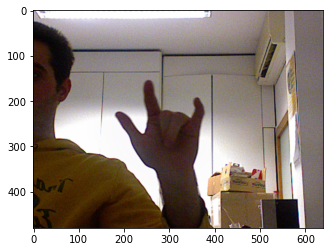

(480, 640, 3)


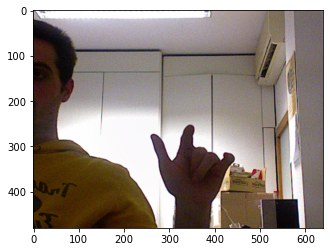

(480, 640, 3)


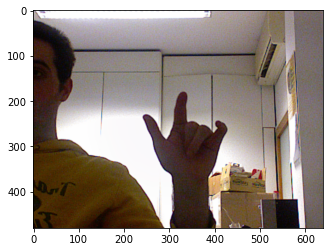

(480, 640, 3)


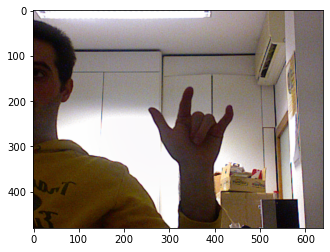

(480, 640, 3)


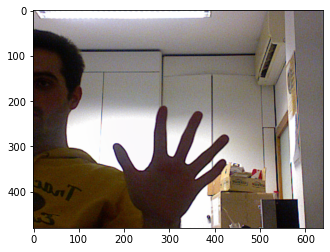

(480, 640, 3)


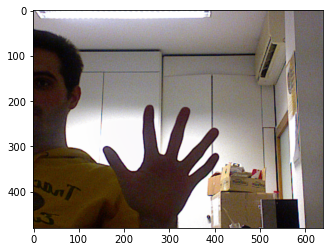

(480, 640, 3)


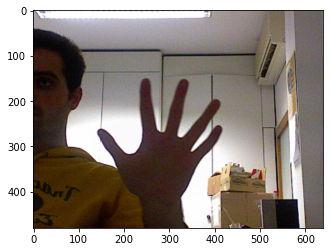

(480, 640, 3)


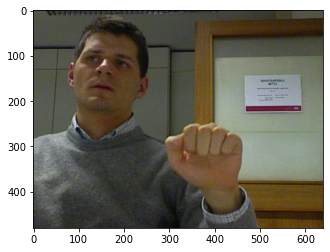

(480, 640, 3)


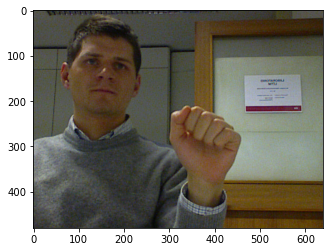

(480, 640, 3)


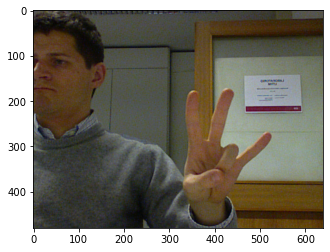

(480, 640, 3)


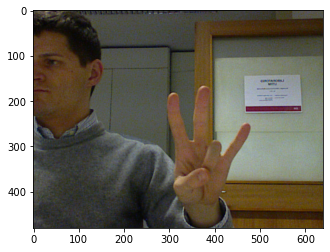

(480, 640, 3)


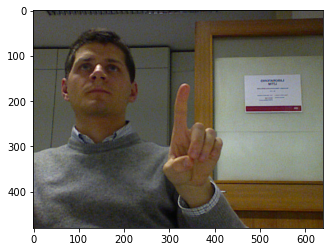

(480, 640, 3)


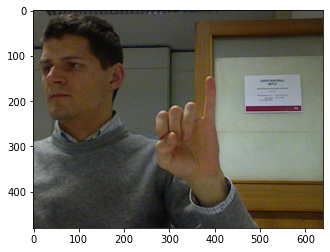

(480, 640, 3)


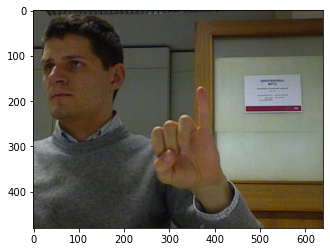

(480, 640, 3)


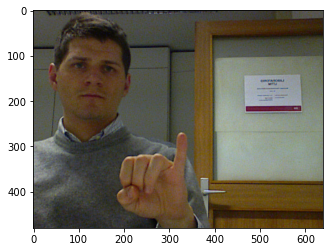

(480, 640, 3)


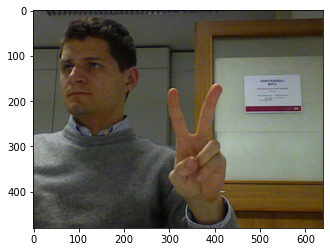

(480, 640, 3)


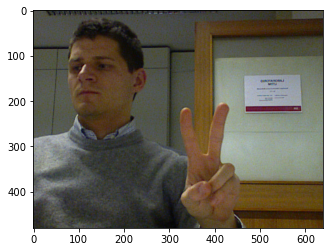

(480, 640, 3)


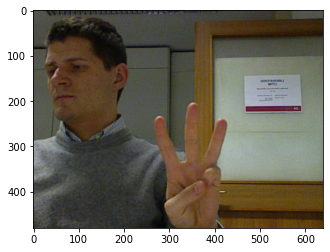

(480, 640, 3)


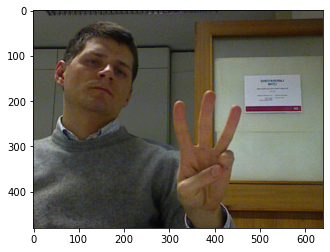

(480, 640, 3)


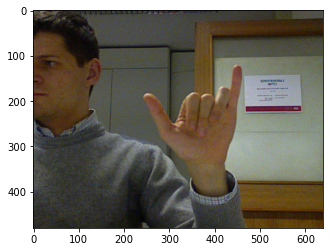

(480, 640, 3)


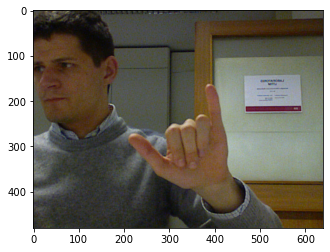

(480, 640, 3)


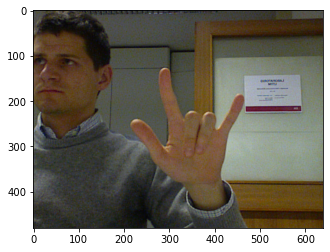

(480, 640, 3)


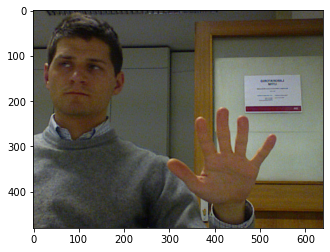

(480, 640, 3)


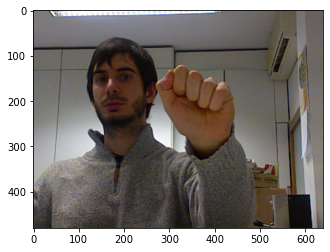

(480, 640, 3)


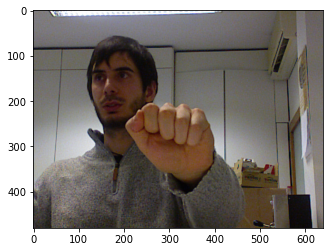

(480, 640, 3)


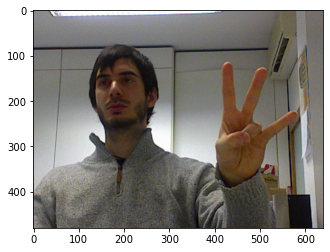

(480, 640, 3)


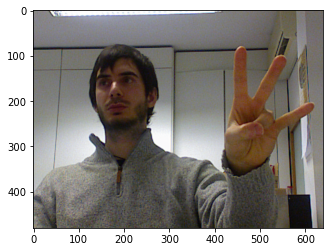

(480, 640, 3)


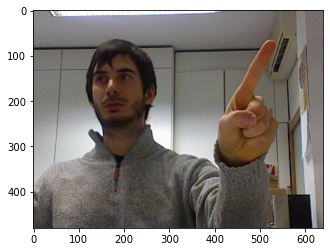

(480, 640, 3)


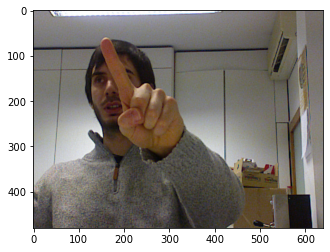

(480, 640, 3)


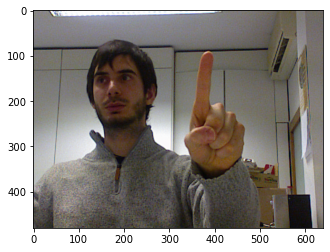

(480, 640, 3)


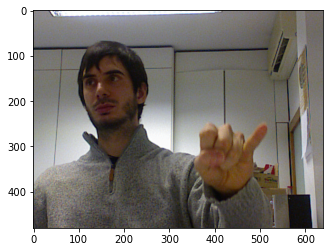

(480, 640, 3)


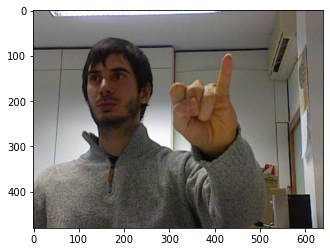

(480, 640, 3)


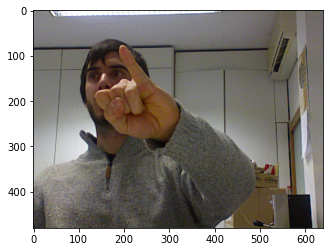

(480, 640, 3)


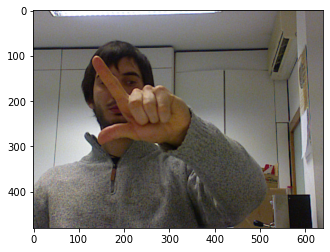

(480, 640, 3)


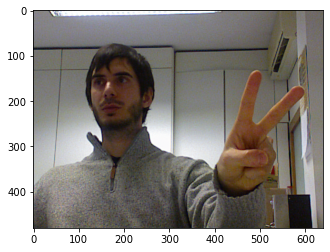

(480, 640, 3)


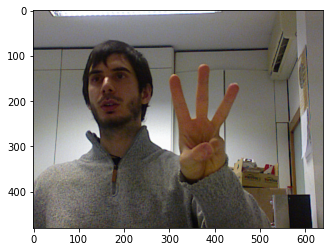

(480, 640, 3)


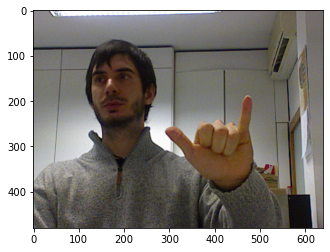

(480, 640, 3)


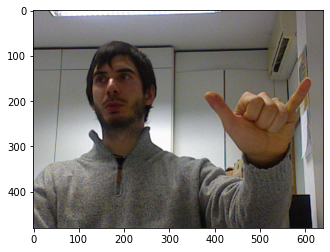

(480, 640, 3)


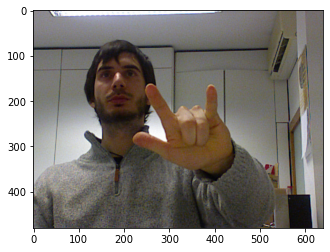

(480, 640, 3)


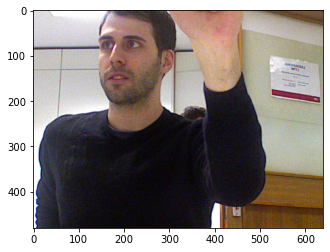

(480, 640, 3)


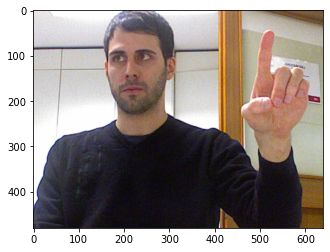

(480, 640, 3)


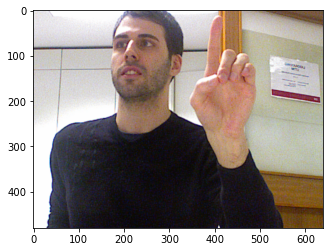

(480, 640, 3)


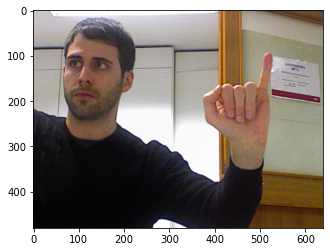

(480, 640, 3)


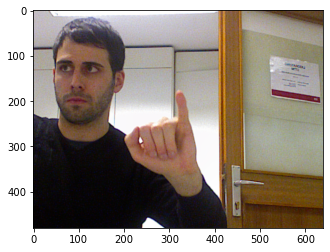

(480, 640, 3)


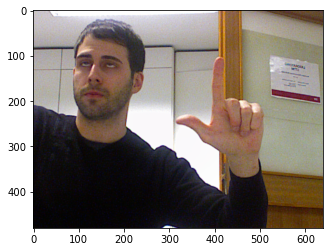

(480, 640, 3)


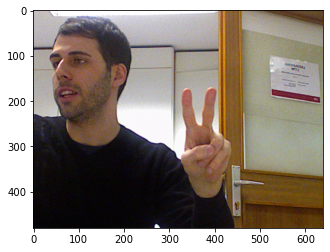

(480, 640, 3)


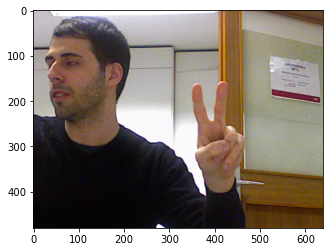

(480, 640, 3)


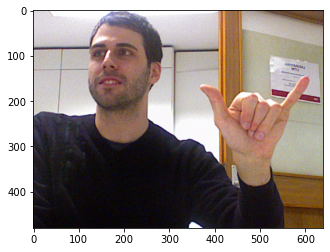

(480, 640, 3)


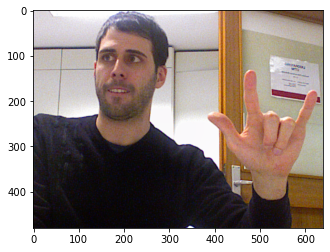

(480, 640, 3)


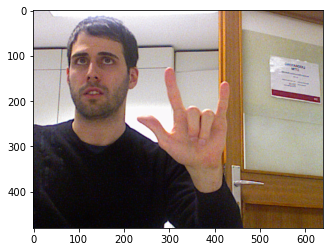

(480, 640, 3)


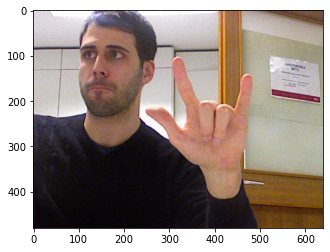

(480, 640, 3)


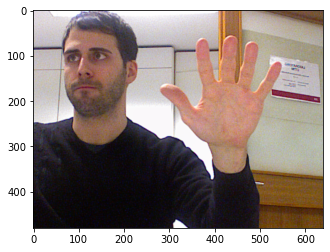

(480, 640, 3)


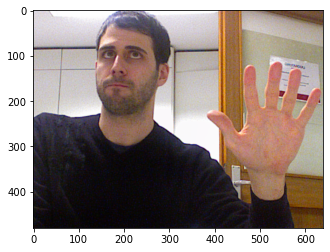

(480, 640, 3)


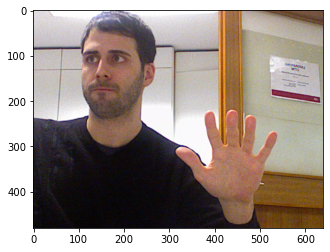

(480, 640, 3)


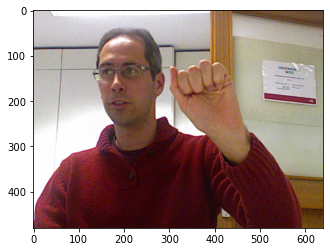

(480, 640, 3)


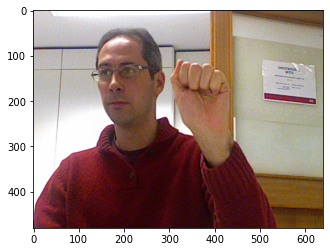

(480, 640, 3)


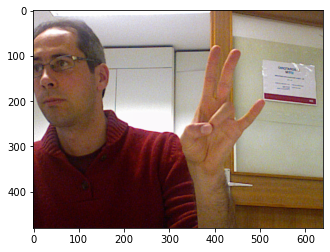

(480, 640, 3)


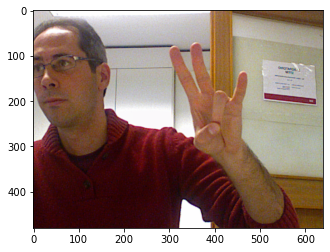

(480, 640, 3)


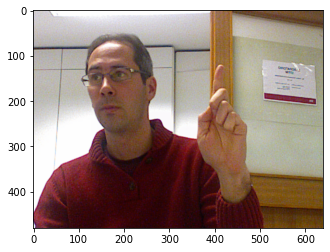

(480, 640, 3)


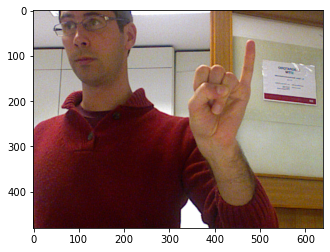

(480, 640, 3)


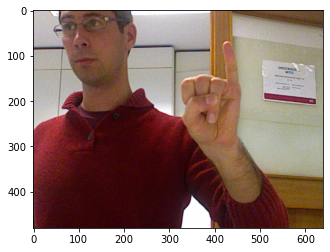

(480, 640, 3)


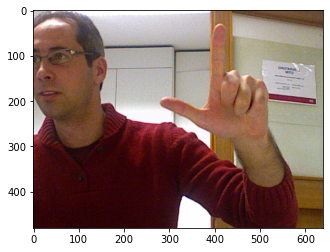

(480, 640, 3)


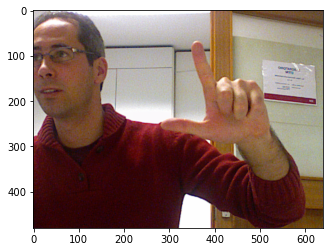

(480, 640, 3)


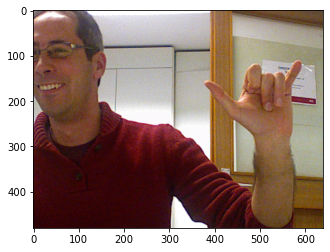

(480, 640, 3)


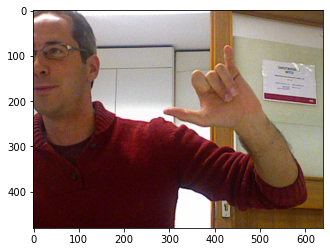

(480, 640, 3)


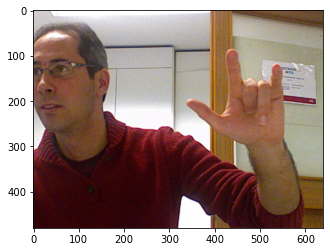

(480, 640, 3)


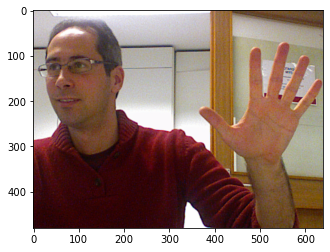

(480, 640, 3)


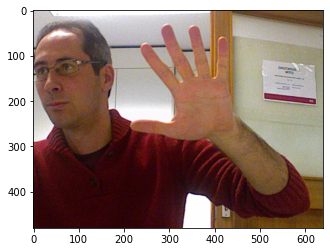

(480, 640, 3)


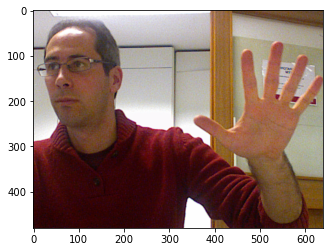

(480, 640, 3)


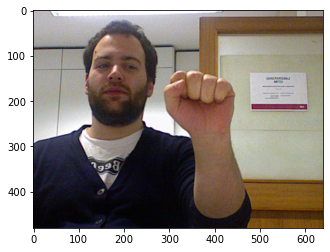

(480, 640, 3)


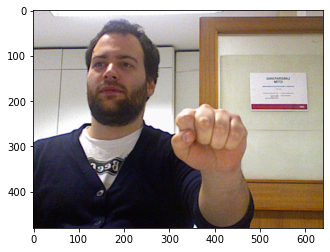

(480, 640, 3)


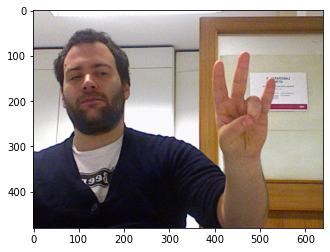

(480, 640, 3)


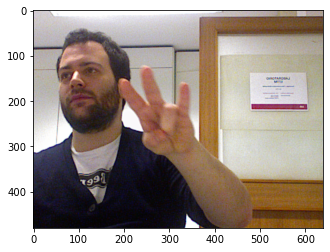

(480, 640, 3)


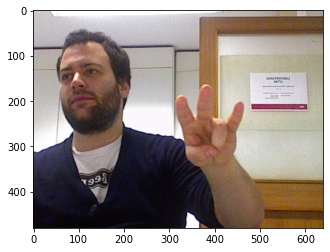

(480, 640, 3)


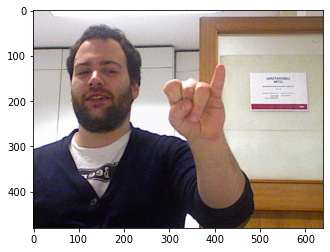

(480, 640, 3)


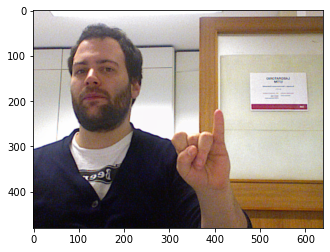

(480, 640, 3)


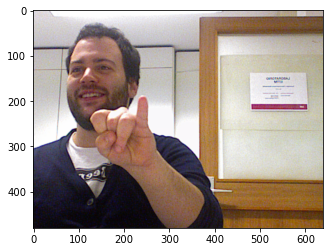

(480, 640, 3)


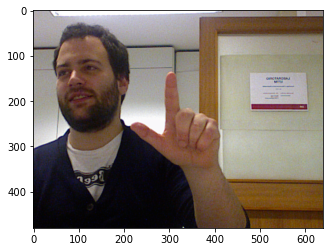

(480, 640, 3)


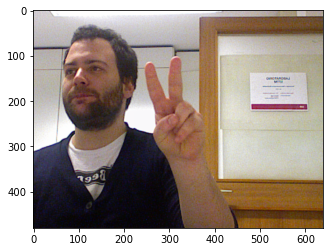

(480, 640, 3)


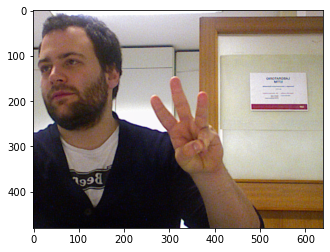

(480, 640, 3)


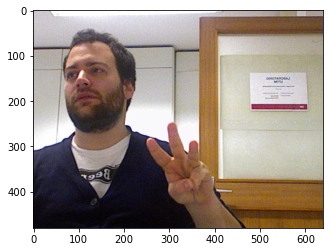

(480, 640, 3)


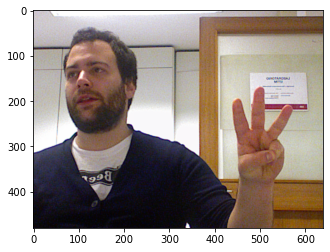

(480, 640, 3)


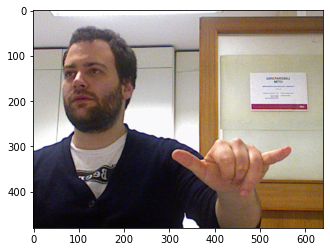

(480, 640, 3)


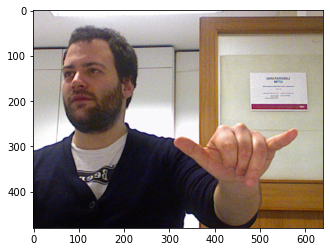

(480, 640, 3)


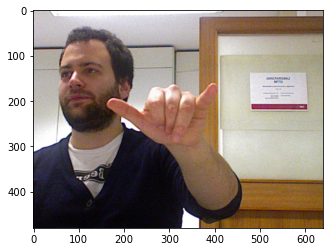

(480, 640, 3)


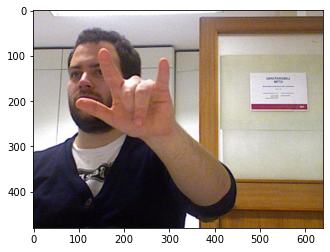

(480, 640, 3)


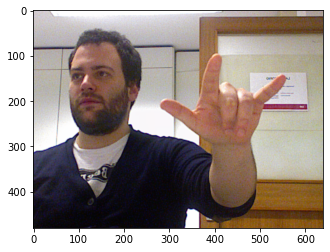

(480, 640, 3)


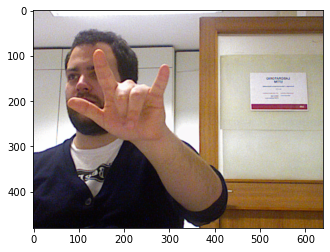

(480, 640, 3)


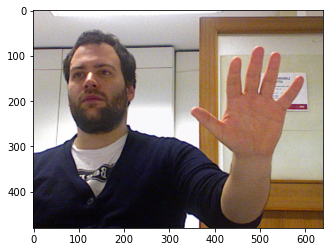

(480, 640, 3)


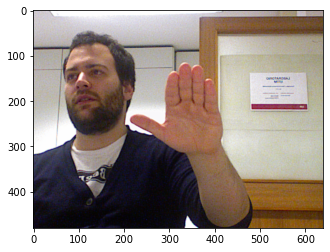

(480, 640, 3)


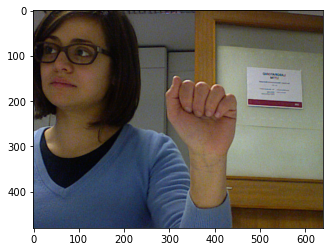

(480, 640, 3)


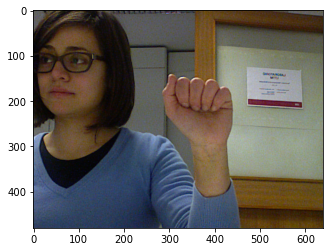

(480, 640, 3)


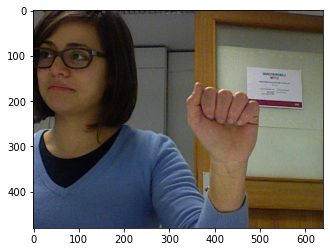

(480, 640, 3)


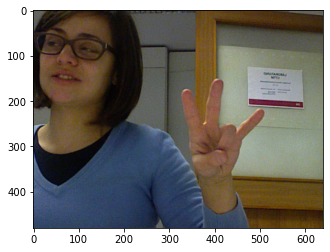

(480, 640, 3)


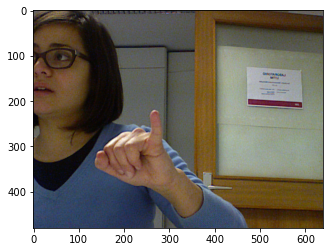

(480, 640, 3)


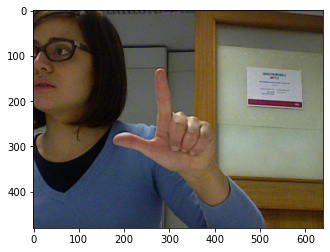

(480, 640, 3)


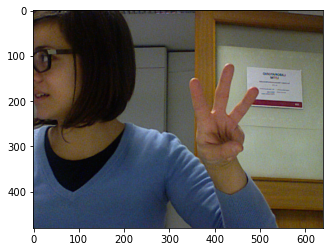

(480, 640, 3)


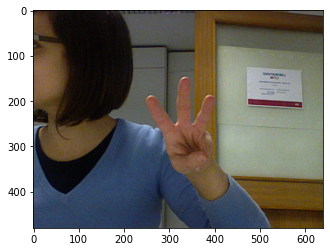

(480, 640, 3)


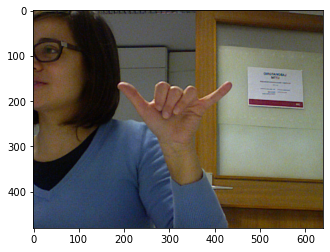

(480, 640, 3)


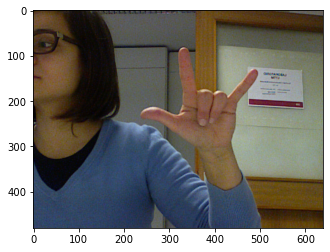

(480, 640, 3)


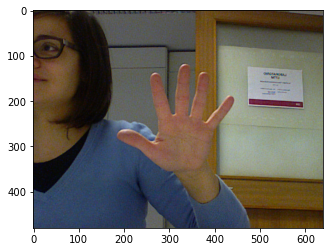

(480, 640, 3)


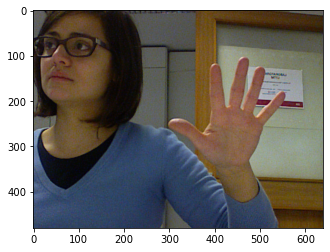

(480, 640, 3)


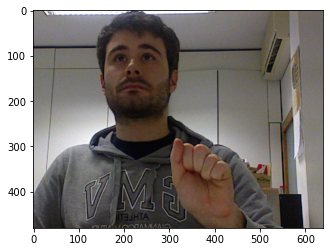

(480, 640, 3)


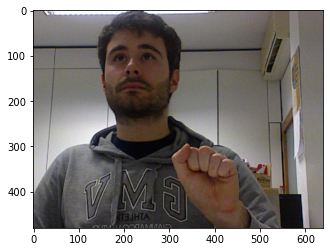

(480, 640, 3)


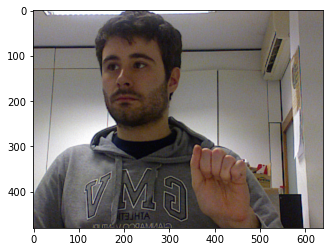

(480, 640, 3)


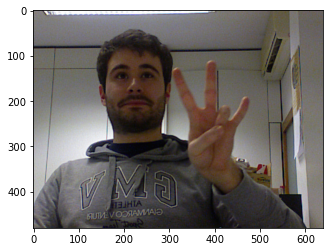

(480, 640, 3)


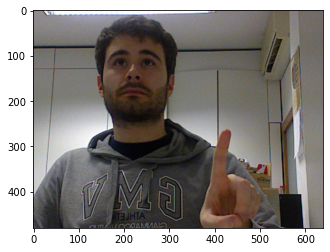

(480, 640, 3)


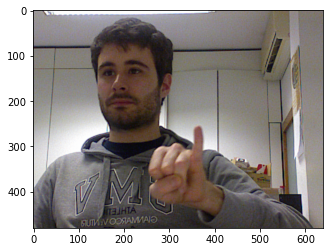

(480, 640, 3)


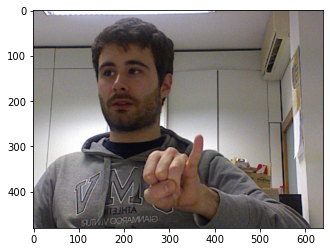

(480, 640, 3)


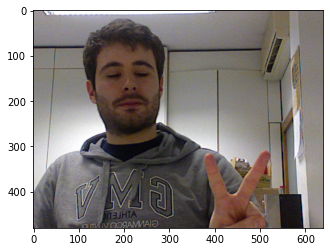

(480, 640, 3)


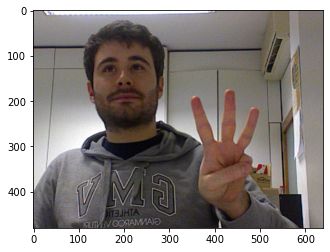

(480, 640, 3)


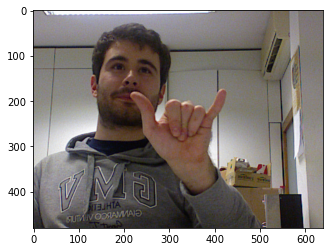

(480, 640, 3)


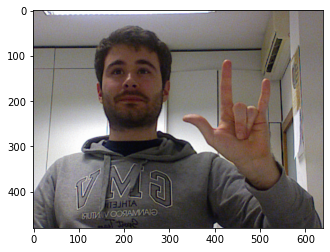

(480, 640, 3)


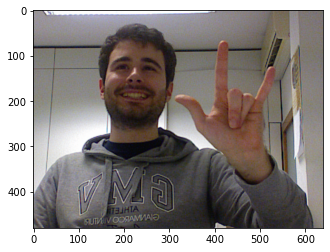

(480, 640, 3)


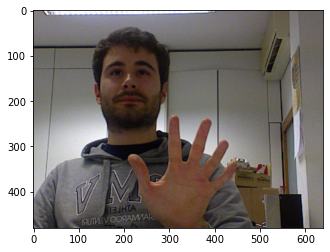

(480, 640, 3)


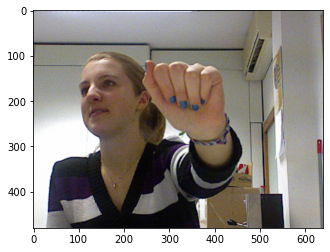

(480, 640, 3)


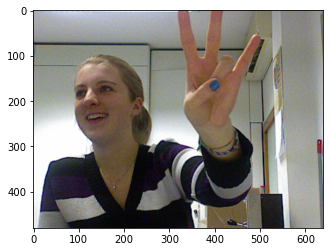

(480, 640, 3)


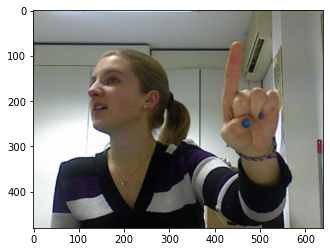

(480, 640, 3)


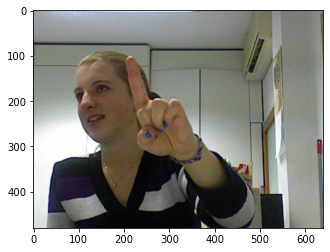

(480, 640, 3)


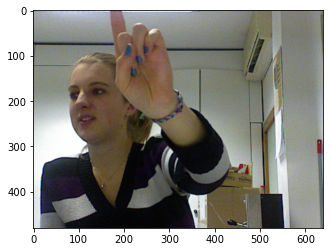

(480, 640, 3)


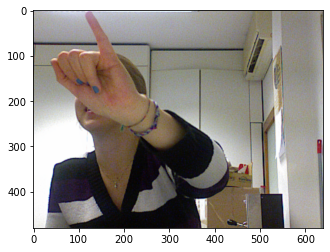

(480, 640, 3)


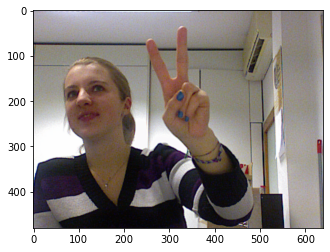

(480, 640, 3)


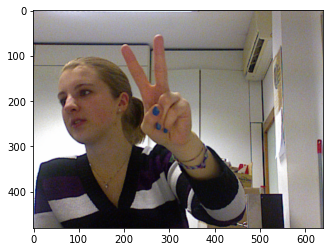

(480, 640, 3)


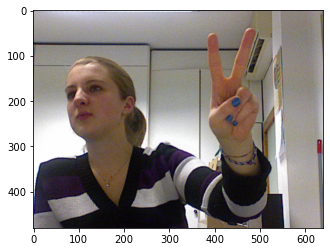

(480, 640, 3)


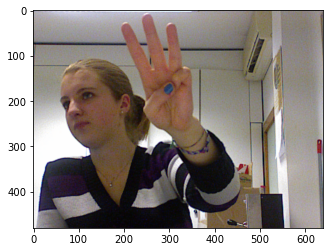

(480, 640, 3)


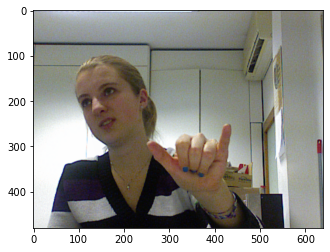

(480, 640, 3)


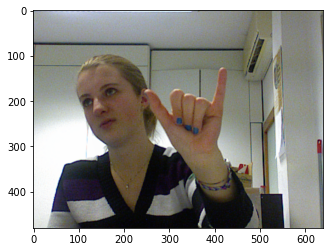

(480, 640, 3)


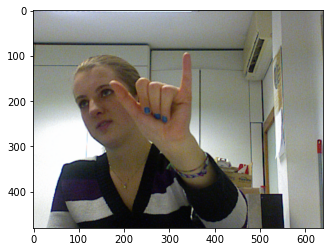

(480, 640, 3)


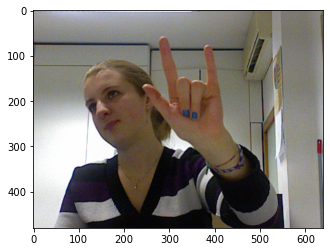

(480, 640, 3)


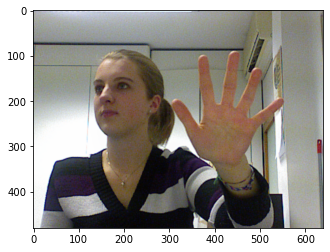

In [121]:
for i, sample in enumerate(TestDataLoader):
#     print(sample)
    x = sample['img'].squeeze()
    y = sample['label']
    plt.imshow(x.cpu().numpy().transpose((1,2,0)))
    print(x.cpu().numpy().transpose((1,2,0)).shape)
    plt.show()

In [ ]:
for path in TestDataset.paths:
    try:
        img = cv2.imread("..\\." + path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (img.shape[1]//4, img.shape[0]//4)).astype(np.uint8)
#         plt.imshow(img)
#         plt.show()
    except:
        print(f"{path} does not exist")
        